**IMPORT LIBRARIES**

In [ ]:
!pip install opencv-python


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import feature
from google.colab.patches import cv2_imshow
from google.colab.patches import cv2_imshow
from skimage.feature import hog


**TASK : Shi-Tomasi Corner Detection**

**Load a different image**

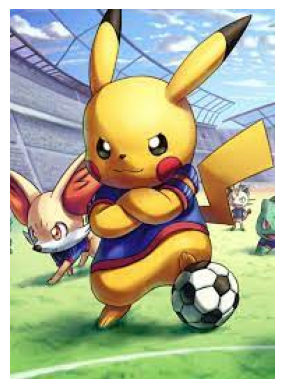

In [ ]:
image = cv2.imread('/content/sample_data/download.jpg')
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.axis('off')
plt.show()

**Implement the Shi-Tomasi Corner Detection algorithm to find the most prominent corners in the image.**

In [ ]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
max_corners = 100
quality_level = 0.01

corners = cv2.goodFeaturesToTrack(gray, maxCorners=max_corners, qualityLevel=quality_level, minDistance=10)
corners = np.int0(corners)


**Display the original image with the detected corners marked as green points.**

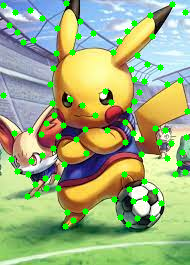

In [ ]:
for corner in corners:
    x, y = corner.ravel()
    cv2.circle(image, (x, y), 3, (0, 255, 0), -1)


cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()


**Adjust the number of corners to be detected by changing the quality level parameter and observe the
results.**

In [ ]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
max_corners = 100
quality_level = 0.05

corners = cv2.goodFeaturesToTrack(gray, maxCorners=max_corners, qualityLevel=quality_level, minDistance=10)
corners = np.int0(corners)


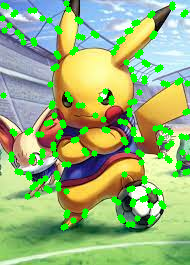

In [ ]:
for corner in corners:
    x, y = corner.ravel()
    cv2.circle(image, (x, y), 3, (0, 255, 0), -1)
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()


**TASK 1. Medical Image Analysis for Tumor Detection (Code &amp; Description)**

**Explain how the concept of edge detection can be applied as a feature extraction technique for tumor
detection in mammograms. Provide a step-by-step description of how edge detection can be used in this
context.**

In [ ]:
''' Explanation:

    Edge detection is a fundamental approach of image processing that can be used to extract features for mammography tumor identification.
    It focuses on locating sharp contrast or color shifts within an image that frequently correspond to the edges of things,
    like tumors in medical pictures. Here is a step-by-step explanation of how edge detection can be applied to mammography tumor detection:

    1 . Preprocessing: First, prepare the mammography image for processing. To ensure that the image is in an appropriate format for analysis,
    this may comprise procedures like noise removal, contrast improvement, and scaling.

    2 . Grayscale Conversion: Convert the mammogram image to grayscale. Grayscale images simplify the analysis by removing color information
    while retaining the intensity variations crucial for detecting edges.

    3 . Edge Detection Algorithm: Use an edge detection technique to analyze the edges of the grayscale image. The Laplacian of Gaussian (LoG),
    the Sobel operator, and the Canny edge detector are common edge detection algorithms. These algorithms compute the gradient of the image and
    indicate regions where the intensity abruptly changes.

    4 . Thresholding: After obtaining the edges, apply a thresholding technique to distinguish between edges caused by anatomical structures and
    those possibly representing tumors. Adaptive thresholding methods, such as Otsu's thresholding, can be useful for this purpose. The threshold
    value can be adjusted based on the image characteristics.

    5 . Region of Interest (ROI) Selection: Choose the regions of interest (ROI) in the mammography where probable malignancies might be present.
    Morphological processes including erosion, dilation, and connected component analysis can be used for this. The location, size, and shape of
    these zones must all be taken into account.

    6 . Feature Extraction: Extract additional features from the identified ROIs to further enhance tumor detection.
    These features may include texture analysis, such as co-occurrence matrices or local binary patterns, which capture patterns within the ROIs.
    Features like shape descriptors (e.g., circularity, aspect ratio) and statistical measures (mean, standard deviation) of intensity can also be valuable.

    7 . Classification: Utilize a machine learning classifier, such as a support vector machine (SVM) or a convolutional neural network (CNN),
    to classify the extracted features and determine whether each ROI contains a tumor or not.

    8 . Post-processing: Perform post-processing steps like removing false positives and refining the detection results for improved accuracy.
    Techniques like non-maximum suppression can help eliminate redundant detections
'''

**In addition to edge detection, propose one more feature extraction technique that can enhance tumor detection
in medical images. Describe this technique, its working mechanism, and why it is suitable for this task.**

In [ ]:
'''
Overview:
Apart from edge detection, Histogram of Oriented Gradients (HOG) is another feature extraction method that can improve the identification of
tumors in medical images, including mammograms.

Operating Principle:
HOG is primarily employed for detecting and recognizing objects by capturing the localized distribution of gradient orientations within an image.
Here is a breakdown of its functioning:

1. Gradient Computation: Calculate the gradients within the grayscale mammogram image to determine the direction and magnitude of intensity variations.
This step commonly employs operators like Sobel or Scharr.

2. Cell Segmentation: Divide the image into smaller cells, with each cell containing a group of pixels. Within each cell, the gradient orientations
are computed.

3. Histogram Generation: Generate a histogram of gradient orientations for each cell. These histograms portray how edges are oriented within each specific
cell.

4. Block Normalization: Combine adjacent cells into blocks and perform histogram normalization within each block. This normalization helps mitigate the
 impact of lighting variations.

5. Feature Vector: Concatenate all the normalized block histograms into a singular feature vector referred to as the HOG descriptor.
This vector encapsulates the image's structural characteristics.



Suitability for Tumor Detection:
Histogram of Oriented Gradients (HOG) is well-suited for detecting tumors in medical images due to the following reasons:

1. Robustness: HOG effectively captures the local structure and shape of objects, imparting robustness against variations in tumor appearance and size.

2. Invariance: It remains invariant to alterations in illumination and contrast, addressing common challenges encountered in medical imaging.

3. Discriminative: HOG features exhibit high discriminative power, enabling the distinction of tumors from the surrounding tissue.

4. Compatibility: HOG features can be seamlessly integrated with diverse classifiers such as Support Vector Machines (SVMs) or Convolutional Neural Networks (CNNs)
to achieve precise tumor detection and classification.

'''

"\nOverview:\nApart from edge detection, Histogram of Oriented Gradients (HOG) is another feature extraction method that can improve the identification of \ntumors in medical images, including mammograms.\n\nOperating Principle:\nHOG is primarily employed for detecting and recognizing objects by capturing the localized distribution of gradient orientations within an image.\nHere is a breakdown of its functioning:\n\n1. Gradient Computation: Calculate the gradients within the grayscale mammogram image to determine the direction and magnitude of intensity variations.\nThis step commonly employs operators like Sobel or Scharr.\n\n2. Cell Segmentation: Divide the image into smaller cells, with each cell containing a group of pixels. Within each cell, the gradient orientations \nare computed.\n\n3. Histogram Generation: Generate a histogram of gradient orientations for each cell. These histograms portray how edges are oriented within each specific \ncell.\n\n4. Block Normalization: Combine 

**DETECTING AND HIGHLIGHTING CONTOURS**

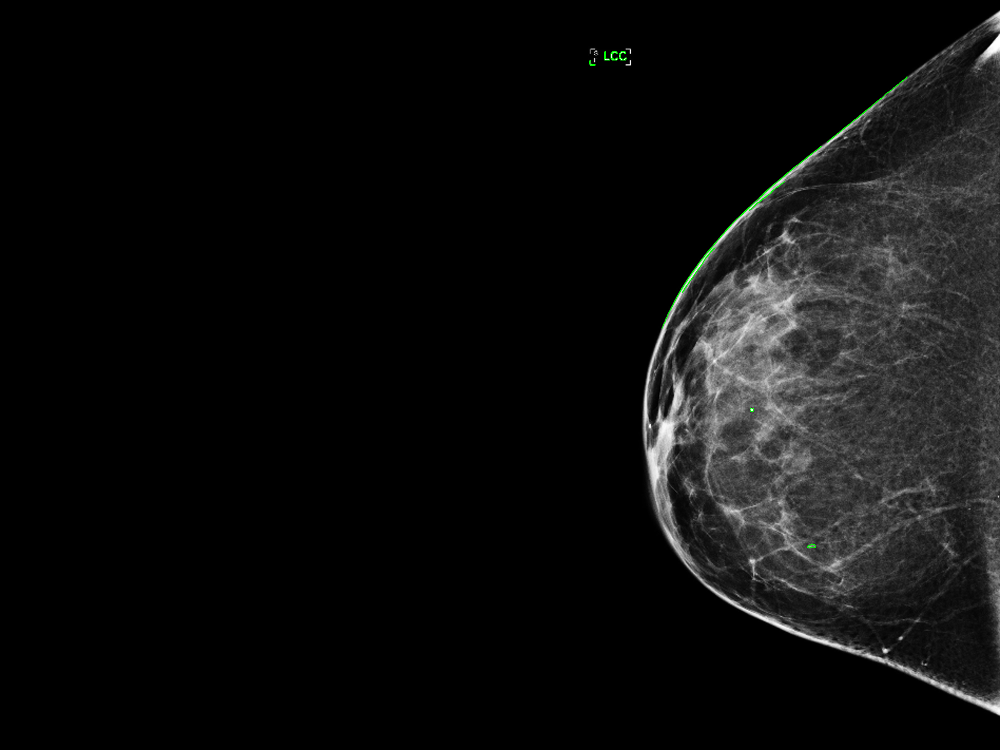

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np


image = cv2.imread('/content/sample_data/Mammogram.jpg')

gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

blurred = cv2.GaussianBlur(gray, (5, 5), 0)

edges = cv2.Canny(blurred, 30, 150)

contours, _ = cv2.findContours(edges.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

for contour in contours:
    area = cv2.contourArea(contour)


    if area < 100:
        continue


    cv2.drawContours(image, [contour], -1, (0, 255, 0), 2)

cv2_imshow(image)


**USING HOG**

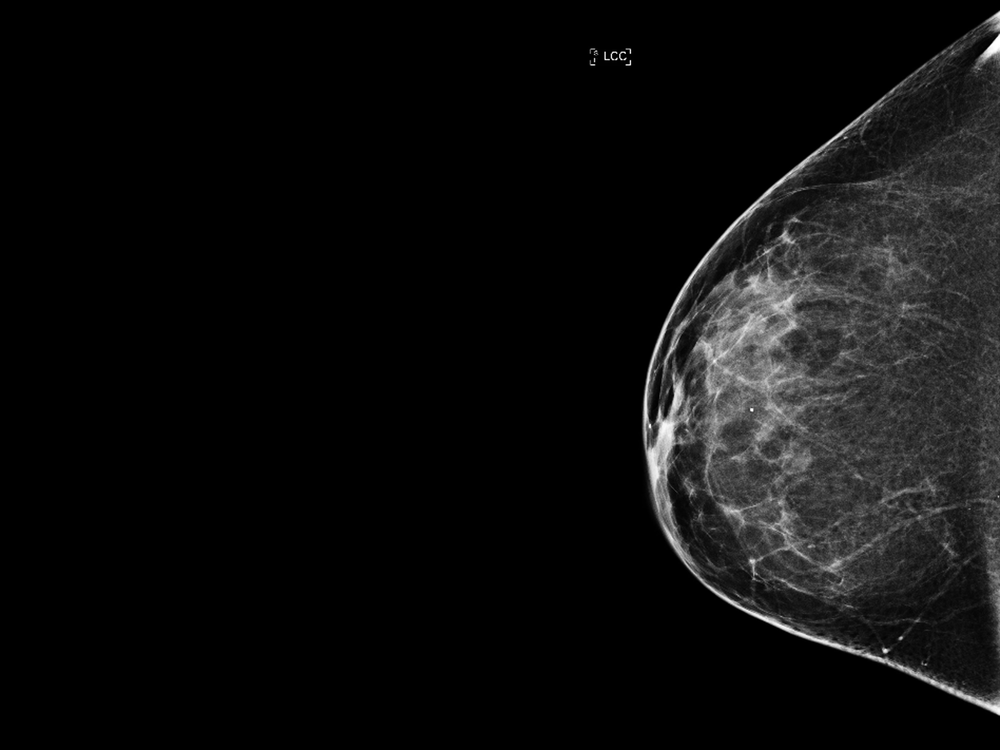

In [ ]:
import cv2
from google.colab.patches import cv2_imshow


image = cv2.imread('/content/sample_data/Mammogram.jpg')

hog = cv2.HOGDescriptor()

rectangles, weights = hog.detectMultiScale(image, winStride=(8, 8), padding=(32, 32), scale=1.05)

for (x, y, w, h) in rectangles:
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

cv2_imshow(image)


**Task 2: Harris Corner Detection**

**Load an image (you can use any image you prefer).**

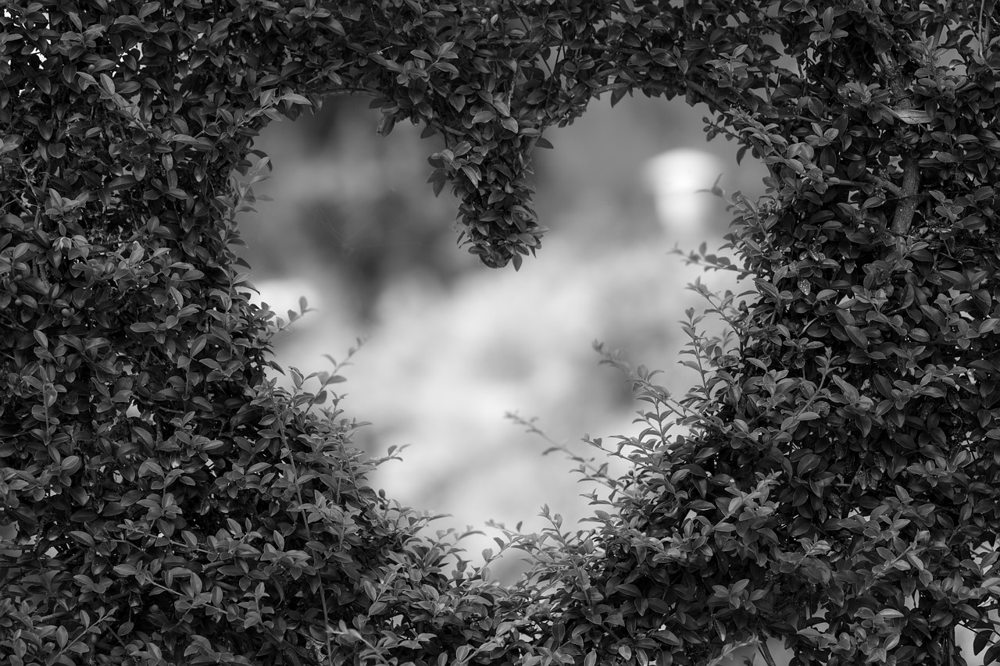

In [ ]:

image = cv2.imread('/content/sample_data/heart-1192662_1280.jpg', cv2.IMREAD_GRAYSCALE)

if image is None:
    print("Error: Unable to load the image.")
else:
    cv2_imshow(image)


**Implement the Harris Corner Detection algorithm to detect corners in the image.**

In [ ]:
block_size = 2
ksize = 3
k = 0.04

corner_response = cv2.cornerHarris(image, block_size, ksize, k)

threshold = 0.01
corner_response_bin = corner_response > threshold * corner_response.max()

**Display the original image with the detected corners marked as red points.**

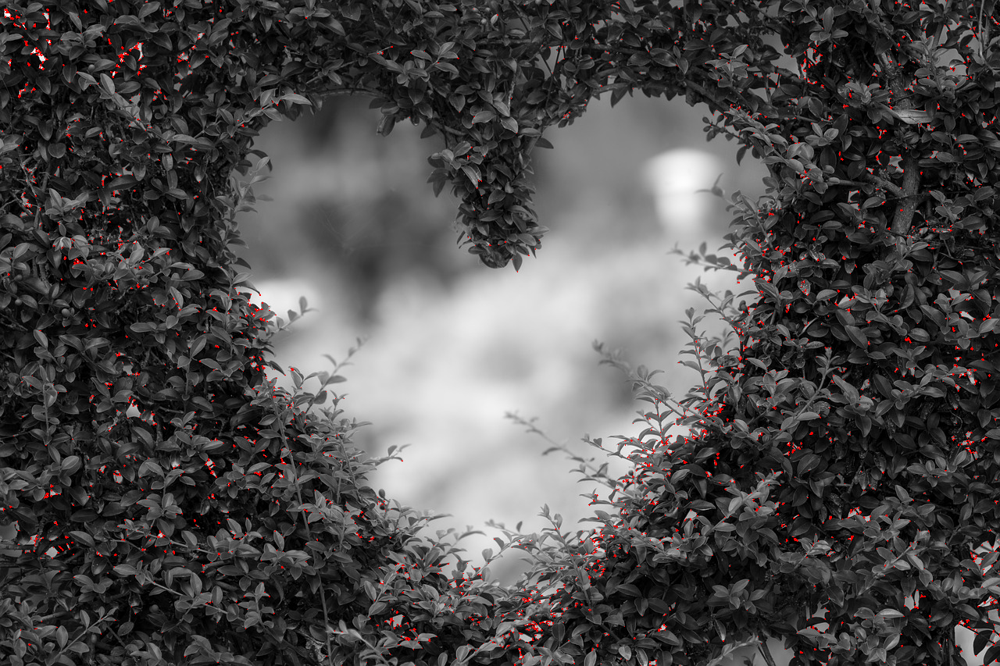

In [ ]:

image_with_corners = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
image_with_corners[corner_response_bin] = [0, 0, 255]

cv2_imshow(image_with_corners)



**Experiment with different threshold values and observe how they affect the corner detection results.**

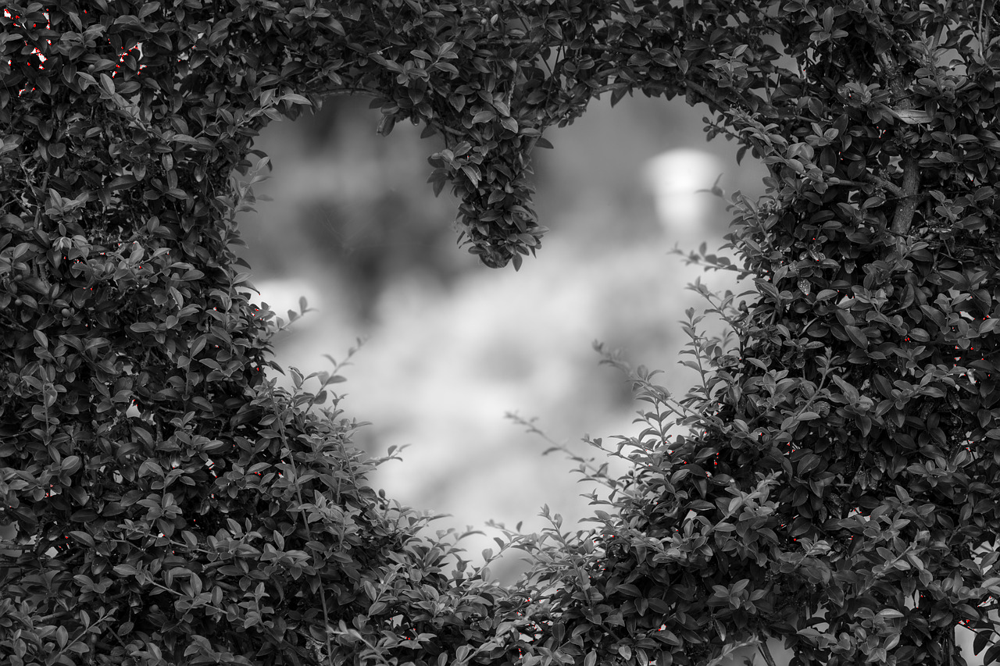

In [ ]:
block_size = 2
ksize = 3
k = 0.04

corner_response = cv2.cornerHarris(image, block_size, ksize, k)

threshold = 0.1
corner_response_bin = corner_response > threshold * corner_response.max()


image_with_corners = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
image_with_corners[corner_response_bin] = [0, 0, 255]

cv2_imshow(image_with_corners)



**Lab Task 3: Corner Detection in Real-time Video**

**Access the video feed from your computer&#39;s webcam or use a pre-recorded video.**

In [ ]:
import cv2

video_path = '/content/sample_data/Line_Twirl_x264.mp4'

cap = cv2.VideoCapture(video_path)


**Implement either the Harris or Shi-Tomasi Corner Detection algorithm to process the video frames and
detect corners.**

In [ ]:
import numpy as np

max_corners = 100
quality_level = 0.3
min_distance = 7


**Display the live video stream with the detected corners marked as points in real-time.**

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

video_path = '/content/sample_data/Line_Twirl_x264.mp4'

cap = cv2.VideoCapture(video_path)


max_corners = 100
quality_level = 0.3
min_distance = 7

while True:

    ret, frame = cap.read()
    if not ret:
        break


    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    corners = cv2.goodFeaturesToTrack(gray, max_corners, quality_level, min_distance)

    if corners is not None:
        corners = np.int0(corners)

        for corner in corners:
            x, y = corner.ravel()
            cv2.circle(frame, (x, y), 5, (0, 255, 0), -1)

    cv2_imshow(frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


**Experiment with different parameters to optimize corner detection for real-time processing.**

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

video_path = '/content/sample_data/Line_Twirl_x264.mp4'

cap = cv2.VideoCapture(video_path)


max_corners = 200
quality_level = 0.9
min_distance = 5

while True:

    ret, frame = cap.read()
    if not ret:
        break


    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    corners = cv2.goodFeaturesToTrack(gray, max_corners, quality_level, min_distance)

    if corners is not None:
        corners = np.int0(corners)

        for corner in corners:
            x, y = corner.ravel()
            cv2.circle(frame, (x, y), 5, (0, 255, 0), -1)

    cv2_imshow(frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


**Lab Task 4: Corner Detection for Image Stitching**

**Choose multiple images that you want to stitch together to create a panorama.**

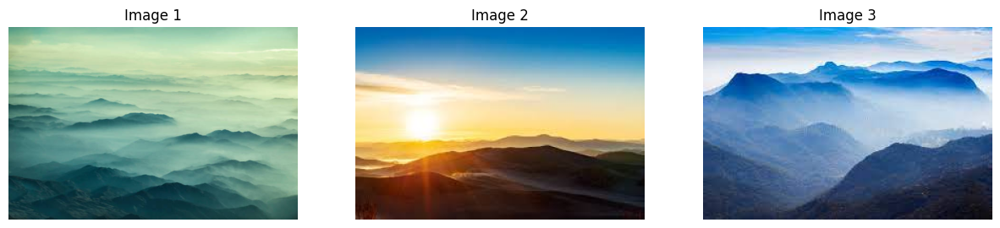

In [ ]:

image_paths = ['/content/sample_data/images3 (1).jpg', '/content/sample_data/images3 (2).jpg', '/content/sample_data/images3 (3).jpg']

num_images = len(image_paths)
fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

for i, image_path in enumerate(image_paths):
    image = cv2.imread(image_path)

    axes[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[i].set_title(f'Image {i + 1}')
    axes[i].axis('off')

plt.show()


**Implement either the Harris or Shi-Tomasi Corner Detection algorithm to detect corners in each image.**

In [ ]:
for i, image_path in enumerate(image_paths):

    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    harris_params = dict(
        blockSize=2,
        ksize=3,
        k=0.04
    )

    corners = cv2.cornerHarris(gray_image, **harris_params)

    image[corners > 0.01 * corners.max()] = [0, 0, 255]

    cv2.imwrite(f'output_image_{i}.jpg', image)


**Display each image with the detected corners marked as points.**

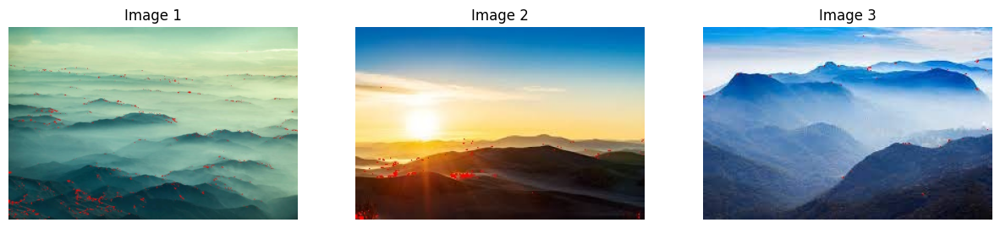

In [ ]:
output_image_paths = ['output_image_0.jpg', 'output_image_1.jpg', 'output_image_2.jpg']

num_images = len(output_image_paths)
fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

for i, output_image_path in enumerate(output_image_paths):
    image = cv2.imread(output_image_path)

    axes[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[i].set_title(f'Image {i + 1}')
    axes[i].axis('off')

plt.show()


**Use the detected corners as key features for image matching and stitching.**

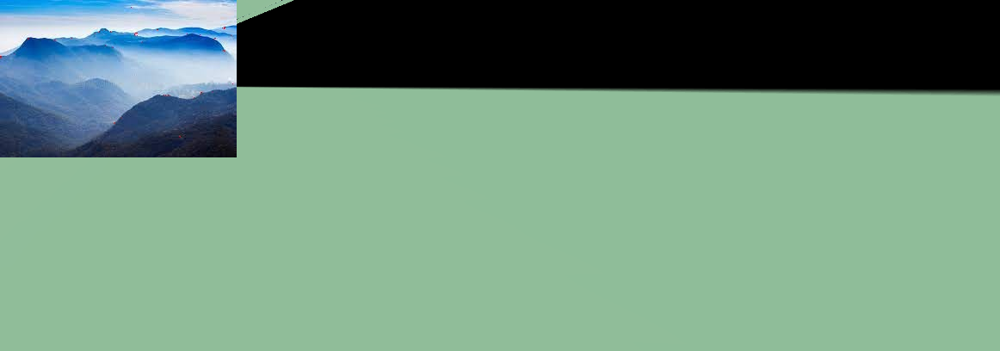

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def stitch_images(image_paths):
    original_images = [cv2.imread(image_path) for image_path in image_paths]
    feature_detector = cv2.ORB_create()

    keypoints_list = []
    descriptors_list = []

    for image in original_images:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        keypoints, descriptors = feature_detector.detectAndCompute(gray_image, None)
        keypoints_list.append(keypoints)
        descriptors_list.append(descriptors)

    matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

    matches = []
    for i in range(len(original_images) - 1):
        matches.append(matcher.match(descriptors_list[i], descriptors_list[i + 1]))
        matches[i] = sorted(matches[i], key=lambda x: x.distance)
        matches[i] = matches[i][:20]

    homography_matrices = []
    for i in range(len(matches)):
        matching_keypoints1 = [keypoints_list[i][match.queryIdx] for match in matches[i]]
        matching_keypoints2 = [keypoints_list[i + 1][match.trainIdx] for match in matches[i]]

        src_points = np.float32([keypoint.pt for keypoint in matching_keypoints2])
        dst_points = np.float32([keypoint.pt for keypoint in matching_keypoints1])

        homography_matrix, _ = cv2.findHomography(src_points, dst_points, cv2.RANSAC, 5.0)

        homography_matrices.append(homography_matrix)

    stitched_image = original_images[0]

    for i in range(1, len(original_images)):
        stitched_image = cv2.warpPerspective(stitched_image, homography_matrices[i - 1], (
            stitched_image.shape[1] + original_images[i].shape[1],
            stitched_image.shape[0]))
        stitched_image[0:original_images[i].shape[0], 0:original_images[i].shape[1]] = original_images[i]

    cv2_imshow(stitched_image)

if __name__ == "__main__":
    image_paths = ['output_image_0.jpg', 'output_image_1.jpg', 'output_image_2.jpg']
    stitch_images(image_paths)


**Lab Task: Feature Detection and Matching using ORB Detector**

Task Instructions:
1. Load Images:
2. Select two different images (e.g., natural scenes, objects, or patterns) that have some common features but
may have variations like rotation, scaling, or perspective changes.
3. Load both images using OpenCV


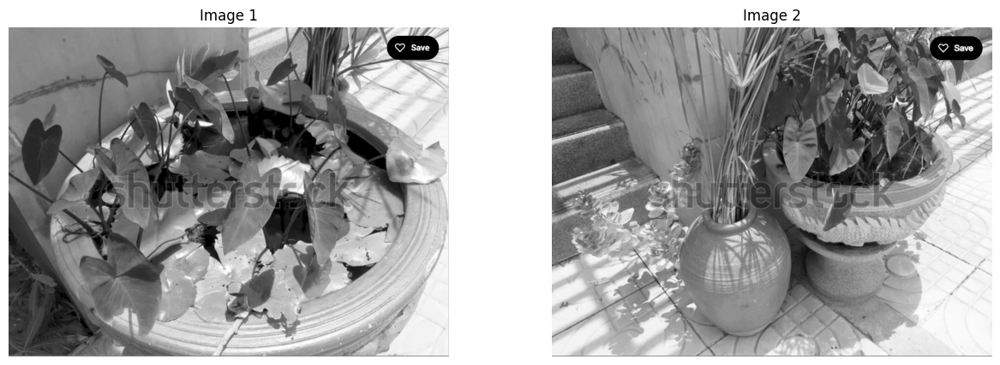

In [ ]:
import cv2
import matplotlib.pyplot as plt

image_paths = ['/content/sample_data/Q5_img1.png', '/content/sample_data/Q5_img2.png']

num_images = len(image_paths)
fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

for i, image_path in enumerate(image_paths):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    axes[i].imshow(image, cmap='gray')
    axes[i].set_title(f'Image {i + 1}')
    axes[i].axis('off')

plt.show()


**Implement the ORB feature detector and descriptor using OpenCV.**

In [ ]:
orb = cv2.ORB_create()

keypoints1, descriptors1 = orb.detectAndCompute(image1, None)
keypoints2, descriptors2 = orb.detectAndCompute(image2, None)


**Detect key points and compute descriptors for both images using ORB.**

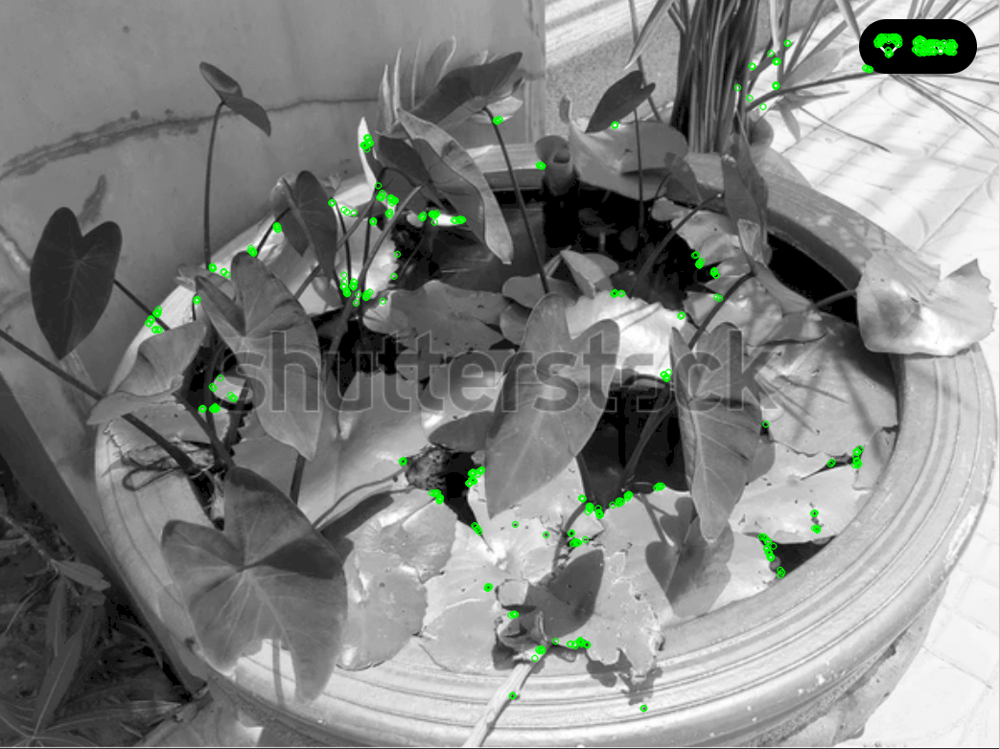

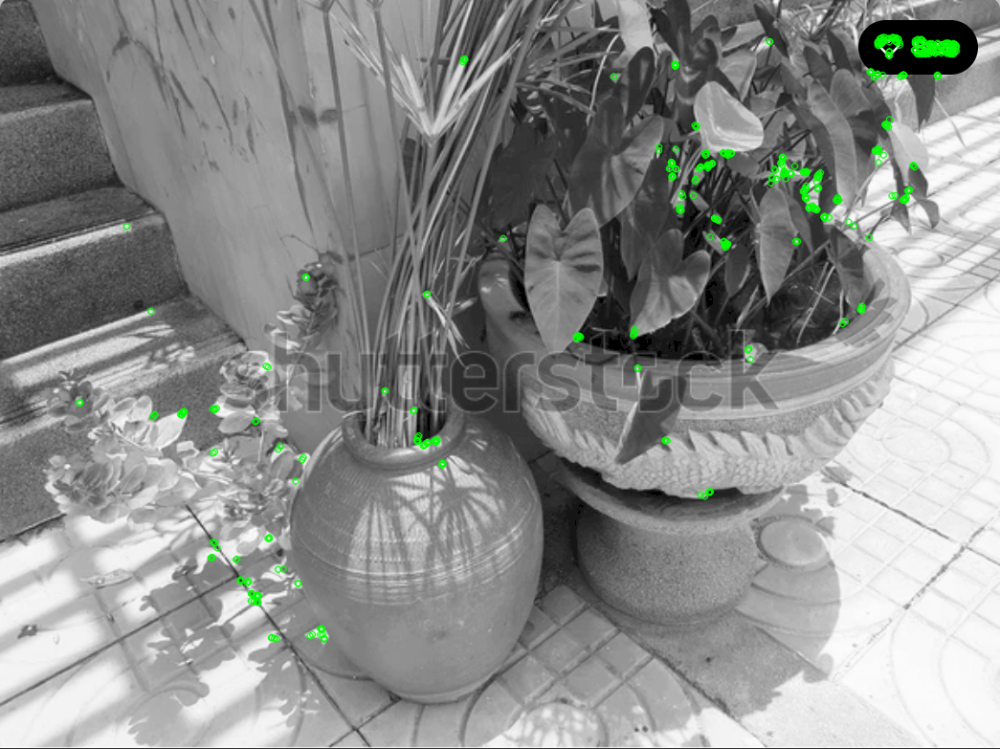

In [ ]:

from google.colab.patches import cv2_imshow
image1_with_keypoints = cv2.drawKeypoints(image1, keypoints1, None, color=(0, 255, 0), flags=0)
image2_with_keypoints = cv2.drawKeypoints(image2, keypoints2, None, color=(0, 255, 0), flags=0)


cv2_imshow(image1_with_keypoints)
cv2_imshow(image2_with_keypoints)


**Matching Features:**

In [ ]:

bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(descriptors1, descriptors2)

matches = sorted(matches, key=lambda x: x.distance)

good_matches = [m for m in matches if m.distance < 50]

result_image = cv2.drawMatches(image1, keypoints1, image2, keypoints2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


**Implement feature matching using the Brute-Force Matcher or FLANN (Fast Library for Approximate
Nearest Neighbors) Matcher.**

In [ ]:
FLANN_INDEX_LSH = 6
index_params = dict(algorithm=FLANN_INDEX_LSH, table_number=6, key_size=12, multi_probe_level=1)
search_params = dict(checks=50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(descriptors1, descriptors2, k=2)

good_matches = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:
        good_matches.append(m)

result_image = cv2.drawMatches(image1, keypoints1, image2, keypoints2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


**Draw Matches:**

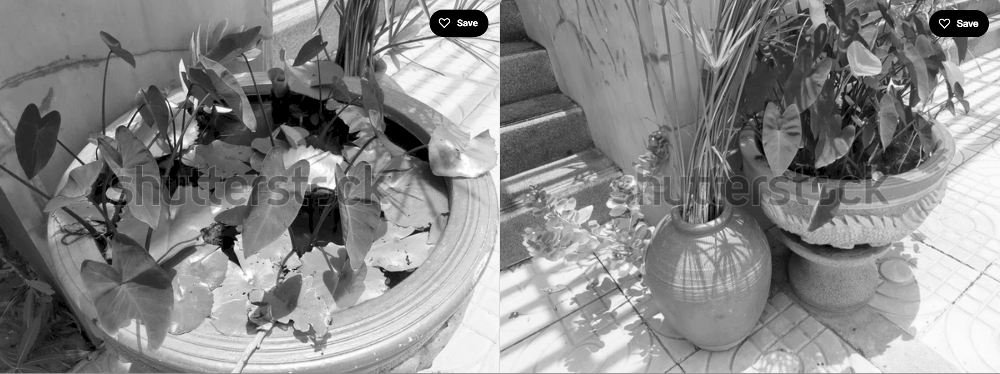

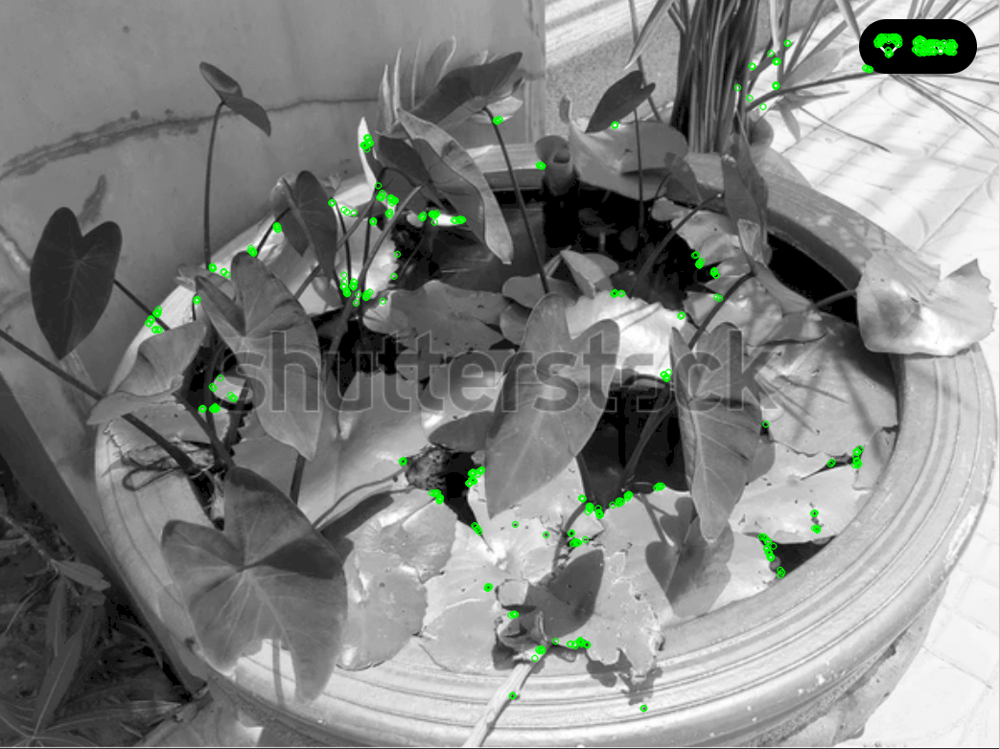

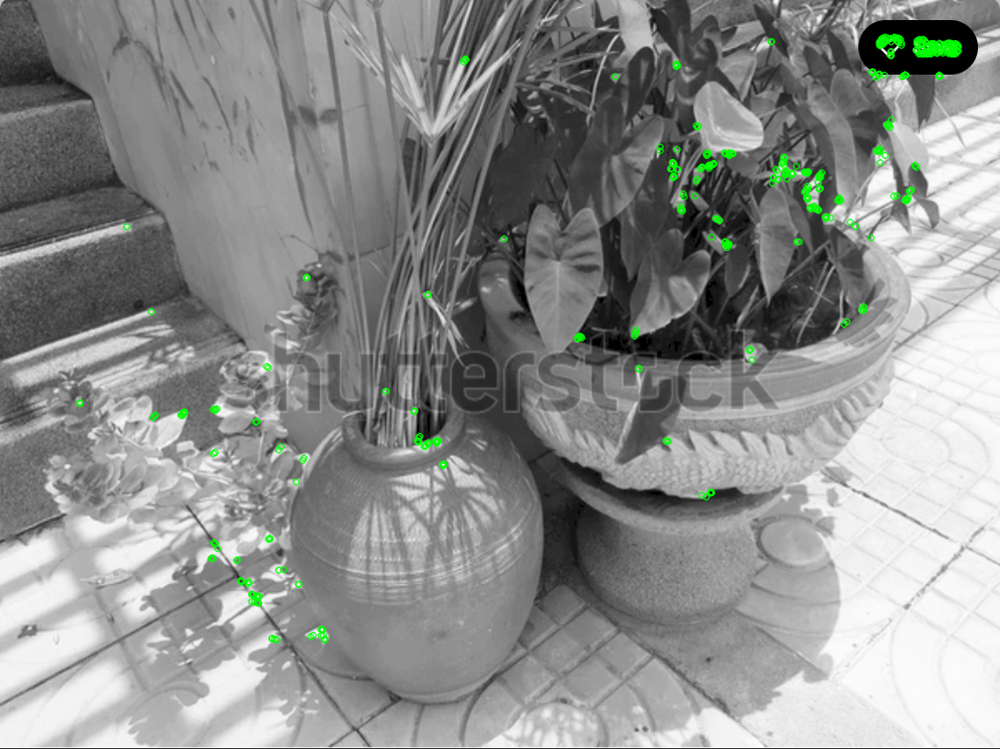

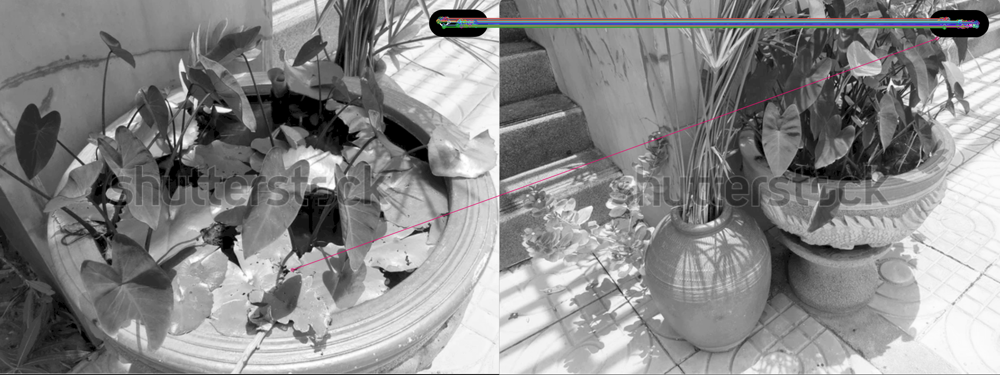

In [ ]:
from google.colab.patches import cv2_imshow

cv2_imshow(np.hstack((image1_resized, image2_resized)))

image1_with_keypoints = cv2.drawKeypoints(image1_resized, keypoints1, None, color=(0, 255, 0), flags=0)
image2_with_keypoints = cv2.drawKeypoints(image2_resized, keypoints2, None, color=(0, 255, 0), flags=0)

cv2_imshow(image1_with_keypoints)
cv2_imshow(image2_with_keypoints)

cv2_imshow(result_image)


**Draw the matches between key points on a new image to visualize the feature matches.**

In [ ]:
image1 = cv2.imread('/content/sample_data/Q5_img1.png', cv2.IMREAD_GRAYSCALE)
image2 = cv2.imread('/content/sample_data/Q5_img2.png', cv2.IMREAD_GRAYSCALE)

orb = cv2.ORB_create()

keypoints1, descriptors1 = orb.detectAndCompute(image1, None)
keypoints2, descriptors2 = orb.detectAndCompute(image2, None)

FLANN_INDEX_LSH = 6
index_params = dict(algorithm=FLANN_INDEX_LSH, table_number=6, key_size=12, multi_probe_level=1)
search_params = dict(checks=50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(descriptors1, descriptors2, k=2)

good_matches = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:
        good_matches.append(m)


**You can use lines or circles to connect matched points.**

In [ ]:
matching_result_image = cv2.drawMatches(image1, keypoints1, image2, keypoints2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)




In [ ]:
matched_keypoints_image = cv2.drawMatchesKnn(image1, keypoints1, image2, keypoints2, matches, None, flags=cv2.DrawMatchesFlags_DEFAULT)


**Display Results:**

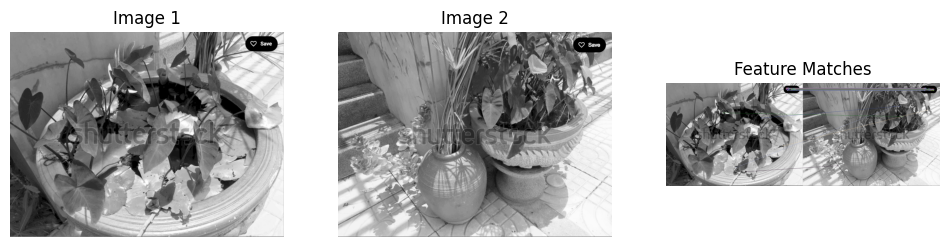

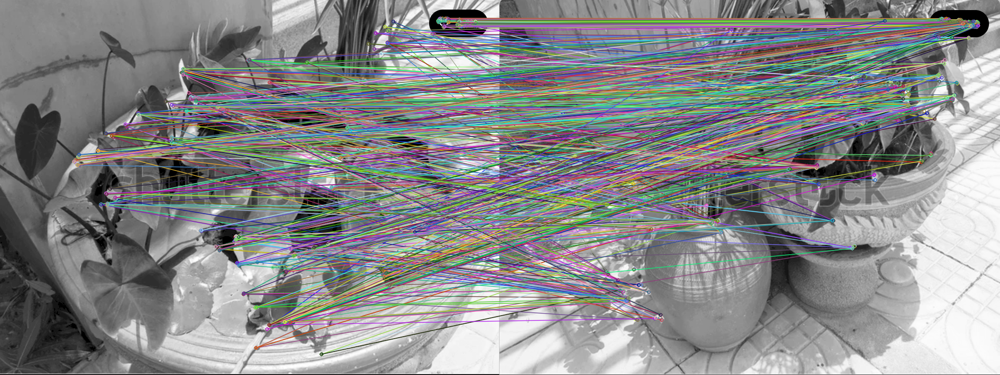

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.subplot(131)
plt.imshow(image1, cmap='gray')
plt.title('Image 1')
plt.axis('off')

plt.subplot(132)
plt.imshow(image2, cmap='gray')
plt.title('Image 2')
plt.axis('off')

plt.subplot(133)
plt.imshow(matching_result_image)
plt.title('Feature Matches')
plt.axis('off')

plt.show()

cv2_imshow(matched_keypoints_image)
cv2.waitKey(0)
cv2.destroyAllWindows()
